In [94]:
# run this first if you want to ignore GPU
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'

In [95]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import os
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from nltk.translate.bleu_score import SmoothingFunction
from resources.bleu import Bleu
from tqdm import tqdm_notebook, tnrange
import keras
from keras_tqdm import TQDMNotebookCallback
print(keras.__version__)
# for arabic text with matplotlib
import bidi.algorithm  as bidialg
import arabic_reshaper

2.12.0


**NOTE:** If a module is not installed (e.g., tqdm), you can install it here in a new cell using the **pip** command preceded by exclamation mark (!) as following:

In [96]:
#!pip3 install tqdm

### Define variables
Here, we define some constant variables that we will use later. Variables include the path of the dataset (images & captions) and the path of other important resources such as the pre-trained VGG16 weights and images embeddings (the output of VGG16 (without the last layer) when fed with Flickr8K dataset).

In [97]:
vgg16_weights_path = 'resources/vgg16_weights_tf_dim_ordering_tf_kernels.h5'
images_directory = 'data/Flickr8k_Dataset/Flicker8k_Dataset/'
arabic_captions_path = 'data/Flickr8k_text/Flickr8k.arabic.full.txt'

images_features_path = 'resources/Flickr8K_features.pkl'
image_size = (224, 224)

images_path = []
images_names = []
captions = {} 
captions_file_text = '' 
vocabulary = [] 

### Transfer Learning
To extract images embeddings using the encoder CNN, we will use VGG16, one of the state-of-the-art models for object detection. This is known as transfer learning, which refers to the situation where what has been learned in one setting (task) is exploited to learn other setting (task). It improve model generalization and fasten training.

We will load the VGG16 model from Keras, load the pre-trianed weights (can be downloaded from [this link](http://www.robots.ox.ac.uk/~vgg/research/very_deep/)), predict on (extarct feature from) Flickr8K images, and finally save extarcted images embeddings to pickle file. Later, we use the extarcted images embeddings (from the pickle file) as input to our model without the need to load VGG16 again. This trick will save us much time, but it has one disadvantage! Fine tuning (re training) the VGG16, which may improve performance, is now not possible!

In [98]:
import tensorflow as tf

def load_vgg16(print_model_summary=False):
    """load the pre-trained VGG16 model"""
    # load VGG16 model with pre-trained weights from ImageNet
    model = tf.keras.applications.VGG16(include_top=True, weights='imagenet')
    # remove last layer (fully connected layer of 1000 neurons) since we are not classifying
    model.layers.pop()
    model = tf.keras.models.Model(inputs=model.inputs, outputs=model.layers[-1].output)
    if print_model_summary:
        model.summary()
    return model

def extract_images_features(img_directory, save_features_to):
    """extract image features using pre-trained VGG16 and save them in a pickle file"""
    features = dict() # to store features from each photo
    # load pre-trained VGG16 model
    pretrained_vgg16 = load_vgg16(False)
    # get image names
    img_names = os.listdir(img_directory)
    for i in range(len(img_names)):
        # full image path
        img_path = os.path.join(img_directory, img_names[i])
        # load image from file
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
        # convert image into numpy array
        img = tf.keras.preprocessing.image.img_to_array(img)
        # reshape image for the model
        img = img.reshape((1,) + img.shape)
        # preprocess image for VGG16
        img = tf.keras.applications.vgg16.preprocess_input(img)
        # get image features
        pred = pretrained_vgg16.predict(img, verbose=0)
        img_name = img_names[i].split('.')[0]
        # store image features
        features[img_name] = pred
    # save image features to pickle file
    pickle.dump(features, open(save_features_to, 'wb'))
    print('image features saved to', save_features_to)

extract_images_features(images_directory, images_features_path)



image features saved to C:/Users/pc/coursS4/MachineLearning/Arabic-Image-Captioning-master/resources/Flickr8K_features.pkl


In [99]:
images_directory

'C:/Users/pc/coursS4/MachineLearning/Arabic-Image-Captioning-master/data/Flickr8k_Dataset/Flicker8k_Dataset/'

In [100]:
images_features_path

'C:/Users/pc/coursS4/MachineLearning/Arabic-Image-Captioning-master/resources/Flickr8K_features.pkl'

In [101]:
img_directory = 'C:/Users/pc/coursS4/MachineLearning/Arabic-Image-Captioning-master/data/Flickr8k_Dataset/Flicker8k_Dataset/'
img_names = os.listdir(img_directory)
img_names 

['Image_1.jpg',
 'Image_10.jpg',
 'Image_100(1).JPG',
 'Image_100.jpg',
 'Image_101.jpg',
 'Image_102.jpg',
 'Image_103.jpg',
 'Image_104.jpg',
 'Image_105.jpg',
 'Image_106.jpg',
 'Image_107.jpg',
 'Image_108.jpg',
 'Image_12.jpg',
 'Image_13.jpg',
 'Image_14.jpg',
 'Image_15.jpg',
 'Image_16.jpg',
 'Image_17.JPG',
 'Image_18.jpg',
 'Image_19.jpg',
 'Image_2.jpg',
 'Image_20.jpg',
 'Image_21.jpg',
 'Image_22.jpg',
 'Image_23.jpg',
 'Image_24.jpg',
 'Image_25.jpg',
 'Image_26.jpg',
 'Image_27.jpg',
 'Image_28.jpg',
 'Image_29.jpg',
 'Image_3.jpg',
 'Image_30.jpg',
 'Image_31.jpg',
 'Image_32.jpg',
 'Image_34.jpg',
 'Image_35.jpg',
 'Image_36.jpg',
 'Image_37.jpg',
 'Image_39.jpg',
 'Image_4.jpg',
 'Image_41.jpg',
 'Image_42.jpg',
 'Image_43.jpg',
 'Image_45.jpg',
 'Image_47.jpg',
 'Image_49.jpg',
 'Image_5.jpg',
 'Image_51.jpg',
 'Image_52.jpg',
 'Image_53.jpg',
 'Image_54.jpg',
 'Image_55.jpg',
 'Image_56.jpg',
 'Image_57.jpg',
 'Image_58.jpg',
 'Image_59.jpg',
 'Image_6.jpg',
 'Image

### Read & visualize dataset

In [102]:
def load_file_text(file_path):
    """reads and returns text in captions file"""
    file = open(file_path, 'r', encoding='utf-8')
    all_text = file.read()
    file.close()
    return all_text

def get_captions(file_text):
    """given file content, returns images names and their captions as dictionary"""
    cpts = {}
    #loop through lines
    for line in file_text.split('\n'): # each line contains image name & its caption separated by tab
        #split by tabs
        img_cpt = line.split('\t')
        if len(img_cpt) != 2: continue
        img, cpt = img_cpt
        #remove image extension & index (remove everything befor the dot)
        img_name = img.split('.')[0]
        #add to dictionary
        if img_name not in cpts:
            cpts[img_name] = [cpt]
        else:
            cpts[img_name].append(cpt)
    return cpts

captions_file_text = load_file_text(arabic_captions_path)
captions = get_captions(captions_file_text)
print('Captions #:', len(captions))
print('Caption example:', list(captions.values())[77])

Captions #: 99
Caption example: ['صفحة تحتوي على أنواع مختلفة من معدات المختبر', 'هذه الصورة تُظهر صفحة تحتوي على أنواع مختلفة من معدات المختبر', 'صورة تُظهر صفحة تحتوي على أنواع مختلفة من معدات المختبر', 'يظهر في الصورة صفحة تحتوي على أنواع مختلفة من معدات المختبر', 'هناك صفحة تحتوي على أنواع مختلفة من معدات المختبر في الصورة']


In [103]:
def visualize_images_with_captions(cpts):
    """plot images with their captions"""
    n_pics = len(cpts)
    i = 0
    fig = plt.figure(figsize=(10,n_pics*4))
    #for i,line in enumerate(lines[:n_pics]):
    for img,cpt in cpts.items():
        img_file = img + '.jpg'
        img = tf.keras.preprocessing.image.load_img(images_directory + img_file)
        cpt_ = '\n'.join(cpt)
        caption = arabic_reshaper.reshape(cpt_)
        caption = bidialg.get_display(caption)
        ax = fig.add_subplot(n_pics,2,2*i+1,xticks=[],yticks=[])
        ax.imshow(img)
        ax = fig.add_subplot(n_pics,2,2*i+2)
        plt.axis('off')
        ax.plot()
        ax.set_xlim(0,1)
        ax.set_ylim(0,1)
        ax.text(0, 0.5, caption, fontsize=20, color='red', weight='normal')
 #'family': 'serif',
        i += 1

subset = {k:captions[k] for k in list(captions.keys())[:-10]}
visualize_images_with_captions(subset)

In [104]:
subset

{'Image_1': ['هذه الصورة تحتوي على المجهر  ',
  'هذه الصورة تحتوي على المجهر واحد',
  'هذه الصورة تحتوي على المجهر الضوئي ',
  'المجهر الضوئي هو نظام بصري به عدسات الغرض منه الحصول على صورة مكبرة للجسم المرصود ',
  'إنه مجهر يسمح لك بمراقبة العناصر غير المرئية بالعين المجردة '],
 'Image_2': ['تحتوي هذه الصورة على عدة معدات معملية ',
  'تحتوي هذه الصورة على المعدات التالية زجاجة مخروطية دوارق حجمية   ماصة  أسطوانة مدرجة حوجلة',
  'تحتوي هذه الصورة على مجموعة معدات معملية تحتوي على سوائل ملونة مختلفة.',
  'تحتوي هذه الصورة على مجموعة دوارق حجمية و معدات مخبرية أخرى تحتوي على محاليل كيميائية مختلفة',
  'انها انواع مختلفة من الاوعية الزجاجية التي يتم استخدامها بشكل كبير وشائع في المختبر وهي تساعد على قياس السوائل المختلفة وبكل دقة'],
 'Image_3': ['انها مجموعة من رموز لأجهزة و معدات للمختبر',
  'تحتوي هذه الصورة على مجموعة من الأدوات المستعملة في المختبر',
  'ملصق بقائمة معدات المختبرات وأسمائها',
  'مجموعة من أنواع مختلفة من الأدواتالمستعملة في المختبر ',
  'تلك هي بعض معدات المختبر ماصات 

### Preprocessing & cleaning captions

In [105]:
import re

text = 'لقطة مقرّبة لمجموعة من السوائل الملونة المختلفة في دورق زجاجي'
re.sub(r'\sو(\w+)', r' و \1', text)

'لقطة مقرّبة لمجموعة من السوائل الملونة المختلفة في دورق زجاجي'

In [106]:
text = 'أكواب ذات سوائل ملونة'
re.sub(r'\bال(\w\w+)', r'\1', text)  # remove al ta3reef

'أكواب ذات سوائل ملونة'

In [107]:
re.search('\w+', ' 456')

<re.Match object; span=(1, 4), match='456'>

In [108]:
captions

{'Image_1': ['هذه الصورة تحتوي على المجهر  ',
  'هذه الصورة تحتوي على المجهر واحد',
  'هذه الصورة تحتوي على المجهر الضوئي ',
  'المجهر الضوئي هو نظام بصري به عدسات الغرض منه الحصول على صورة مكبرة للجسم المرصود ',
  'إنه مجهر يسمح لك بمراقبة العناصر غير المرئية بالعين المجردة '],
 'Image_2': ['تحتوي هذه الصورة على عدة معدات معملية ',
  'تحتوي هذه الصورة على المعدات التالية زجاجة مخروطية دوارق حجمية   ماصة  أسطوانة مدرجة حوجلة',
  'تحتوي هذه الصورة على مجموعة معدات معملية تحتوي على سوائل ملونة مختلفة.',
  'تحتوي هذه الصورة على مجموعة دوارق حجمية و معدات مخبرية أخرى تحتوي على محاليل كيميائية مختلفة',
  'انها انواع مختلفة من الاوعية الزجاجية التي يتم استخدامها بشكل كبير وشائع في المختبر وهي تساعد على قياس السوائل المختلفة وبكل دقة'],
 'Image_3': ['انها مجموعة من رموز لأجهزة و معدات للمختبر',
  'تحتوي هذه الصورة على مجموعة من الأدوات المستعملة في المختبر',
  'ملصق بقائمة معدات المختبرات وأسمائها',
  'مجموعة من أنواع مختلفة من الأدواتالمستعملة في المختبر ',
  'تلك هي بعض معدات المختبر ماصات 

In [109]:
from string import punctuation

def preprocess_captions(cpts):
    """ clean captions to reduce vocabulary size we need to work with:
        - lowercase
        - remove punctuations
        - remove one-character words
        - remove words with numbers
    """
    for img, cpt in cpts.items():
        cpts_ = []
        for c in cpt:
            c = c.lower() #lower case all caption
            c = ''.join([char for char in c if char not in punctuation]) #remove punctuations
            c = ' '.join([w for w in c.split() if len(w)>1 and w.isalpha()]) #remove one-character & numeric words
            cpts_.append(c)
        cpts[img] = cpts_
k = 'Image_26' 
print('before >>', captions[k])
preprocess_captions(captions)
print('captions preprocessed :)')
print('after >>', captions[k])

before >> ['مجهر أحمر وأنابيب اختبار على منضدة', 'تُظهر الصورة مجهرًا أحمر اللون يُوضع على منضدة في المختبر يتميز المجهر بتصميمه المتقدم والعصري ويوفر إمكانية رؤية تفاصيل دقيقة في العينات', 'يُعد وجود المجهر الأحمر والأنابيب الاختبارية على المنضدة إشارة لنشاط البحث والتحليل المستمر في المختبر', 'المجهر الأحمر والأنابيب الاختبارية يعكسان التقدم التكنولوجي والتطور في مجال المختبرات ', 'وجود المجهر الأحمر والأنابيب الاختبارية على المنضدة يدل على التركيز والاهتمام بالعمل العلمي في المختبر ']
captions preprocessed :)
after >> ['مجهر أحمر وأنابيب اختبار على منضدة', 'الصورة أحمر اللون على منضدة في المختبر يتميز المجهر بتصميمه المتقدم والعصري ويوفر إمكانية رؤية تفاصيل دقيقة في العينات', 'وجود المجهر الأحمر والأنابيب الاختبارية على المنضدة إشارة لنشاط البحث والتحليل المستمر في المختبر', 'المجهر الأحمر والأنابيب الاختبارية يعكسان التقدم التكنولوجي والتطور في مجال المختبرات', 'وجود المجهر الأحمر والأنابيب الاختبارية على المنضدة يدل على التركيز والاهتمام بالعمل العلمي في المختبر']


In [110]:
from resources.arabic_preprocessing import Arabic_preprocessing

def preprocess_captions(cpts):
    """ clean captions to get rid of useless textual info & reduce vocabulary size. Preprocessing includes:
        - remove punctuations & diacritics
        - normalize (or standarize) Hamza & Ha2
        - remove repeating characters
        - remove english characters
        - remove one-character words
    """
    process_arab = Arabic_preprocessing()
    for img, cpt in cpts.items():
        processed_captions = [process_arab.preprocess_arabic_text(c) for c in cpt]
        cpts[img] = processed_captions

k = 'Image_26' 
print('before >>', captions[k])
preprocess_captions(captions)
print('captions preprocessed :)')
print('after >>', captions[k])

before >> ['مجهر أحمر وأنابيب اختبار على منضدة', 'الصورة أحمر اللون على منضدة في المختبر يتميز المجهر بتصميمه المتقدم والعصري ويوفر إمكانية رؤية تفاصيل دقيقة في العينات', 'وجود المجهر الأحمر والأنابيب الاختبارية على المنضدة إشارة لنشاط البحث والتحليل المستمر في المختبر', 'المجهر الأحمر والأنابيب الاختبارية يعكسان التقدم التكنولوجي والتطور في مجال المختبرات', 'وجود المجهر الأحمر والأنابيب الاختبارية على المنضدة يدل على التركيز والاهتمام بالعمل العلمي في المختبر']
captions preprocessed :)
after >> ['مجهر احمر وانابيب اختبار علي منضده', 'الصوره احمر اللون علي منضده في المختبر يتميز المجهر بتصميمه المتقدم والعصري ويوفر امكانيه رؤيه تفاصيل دقيقه في العينات', 'وجود المجهر الاحمر والانابيب الاختباريه علي المنضده اشاره لنشاط البحث والتحليل المستمر في المختبر', 'المجهر الاحمر والانابيب الاختباريه يعكسان التقدم التكنولوجي والتطور في مجال المختبرات', 'وجود المجهر الاحمر والانابيب الاختباريه علي المنضده يدل علي التركيز والاهتمام بالعمل العلمي في المختبر']


In [111]:
i = 0
for k,v in captions.items():
    print(v)
    i += 1
    if i == 10: break

['هذه الصوره تحتوي علي المجهر', 'هذه الصوره تحتوي علي المجهر واحد', 'هذه الصوره تحتوي علي المجهر الضوئي', 'المجهر الضوئي هو نظام بصري به عدسات الغرض منه الحصول علي صوره مكبره للجسم المرصود', 'انه مجهر يسمح لك بمراقبه العناصر غير المرئيه بالعين المجرده']
['تحتوي هذه الصوره علي عده معدات معمليه', 'تحتوي هذه الصوره علي المعدات التاليه زجاجه مخروطيه دوارق حجميه ماصه اسطوانه مدرجه حوجله', 'تحتوي هذه الصوره علي مجموعه معدات معمليه تحتوي علي سوائل ملونه مختلفه', 'تحتوي هذه الصوره علي مجموعه دوارق حجميه معدات مخبريه اخري تحتوي علي محاليل كيميائيه مختلفه', 'انها انواع مختلفه من الاوعيه الزجاجيه التي يتم استخدامها بشكل كبير وشائع في المختبر وهي تساعد علي قياس السوائل المختلفه وبكل دقه']
['انها مجموعه من رموز لاجهزه معدات للمختبر', 'تحتوي هذه الصوره علي مجموعه من الادوات المستعمله في المختبر', 'ملصق بقائمه معدات المختبرات واسمائها', 'مجموعه من انواع مختلفه من الادواتالمستعمله في المختبر', 'تلك هي بعض معدات المختبر ماصات رف انبوب اختبار انبوب اختبار دورق موقد بنسن موقد كحول حقنه اسطوانه مدرجه قطار

In [112]:
for k,v in captions.items():
    for cpt in v:
        a = [w for w in cpt.split() if len(w)==1 and w!='و']
        if len(a)>0: print(cpt)

In [113]:
%%time
def get_vocabulary(cpts):
    """retruns a list of all unique words in captions"""
    captions_flattened = [cpt for image_captions in cpts.values() for cpt in image_captions]
    all_captions = ' '.join(captions_flattened)
    v = set(all_captions.split())
    return sorted(list(v))

vocabulary = get_vocabulary(captions)
print('Vocabulary size (number of unique words):', len(vocabulary))

Vocabulary size (number of unique words): 846
CPU times: total: 15.6 ms
Wall time: 11.2 ms


In [114]:
%%time
def get_frequent_vocabulary(cpts, frequency=5):
    """retruns a list of all unique words that appeared more than `frequency` times"""
    captions_flattened = [cpt for image_captions in cpts.values() for cpt in image_captions]
    all_captions = ' '.join(captions_flattened)
    frequent_vocabulary = []
    for i,v in enumerate(vocabulary):
        if all_captions.count(v) >= frequency: frequent_vocabulary.append(v)
    return frequent_vocabulary

frequent_vocabulary = get_frequent_vocabulary(captions, 3)
print('Frequent vocabulary size (number of unique words):', len(frequent_vocabulary))

Frequent vocabulary size (number of unique words): 428
CPU times: total: 46.9 ms
Wall time: 69.6 ms


In [115]:
%%time

def vocab_counts(cpts, vocab):
    captions_flattened = [cpt for image_captions in cpts.values() for cpt in image_captions]
    all_captions = ' '.join(captions_flattened)
    vocab_dict = {}
    for w in vocab:
        vocab_dict[w] = all_captions.count(w)
    return vocab_dict

def get_word_given_count(vocab_counts, count):
    for k,v in vocab_counts.items():
        if v == count:
            return k

vocabulary_counts = vocab_counts(captions, frequent_vocabulary)
max_word_count = max(list(vocabulary_counts.values()))
min_word_count = min(list(vocabulary_counts.values()))
max_word = get_word_given_count(vocabulary_counts, max_word_count)
min_word = get_word_given_count(vocabulary_counts, min_word_count)
print('the word that appeared the most is:', max_word, ' It appeared', max_word_count, 'times')
print('the word that appeared the least is:', min_word, ' It appeared', min_word_count, 'times')

the word that appeared the most is: في  It appeared 337 times
the word that appeared the least is: استخدامه  It appeared 3 times
CPU times: total: 31.2 ms
Wall time: 29.5 ms


In [116]:
def add_start_end_to_captions(cpts):
    """precede each caption with <START> and end each caption with <END>"""
    start, end = '<START>', '<END>'
    #start, end = 'start', 'end'
    for k, v in cpts.items():
        image_captions = [start + ' ' + cpt + ' ' + end for cpt in v]
        cpts[k] = image_captions

add_start_end_to_captions(captions)
print(captions[k])

['<START> كتاب اصفر يحمل اسم يوضع علي خلفيه بيضاء <END>', '<START> كتاب اصفر يحمل اسم موضوع علي خلفيه بيضاء <END>', '<START> كتاب اصفر يحمل عنوان موضوع علي خلفيه بيضاء <END>', '<START> كتاب اصفر يحمل اسم موضوع علي خلفيه بيضاء <END>', '<START> كتاب اصفر يحمل عنوان موضوع علي خلفيه بيضاء <END>']


In [117]:
# load image embeddings extracted from VGG16 earlier
features = pickle.load(open(images_features_path, 'rb'))

XX, yy = [], []
for k,v in captions.items():
    if k in features:
        #get input (image features)
        XX.append(features[k])
        #get output (image caption)
        yy.append(v)

In [118]:
X, y = [],[]
for image_features, image_captions in zip(XX,yy):
    for image_caption in image_captions:
        X.append(image_features)
        y.append(image_caption)
print(len(X),len(y))

494 494


In [119]:
print(len(captions))

99


In [120]:
print(len(X))

494


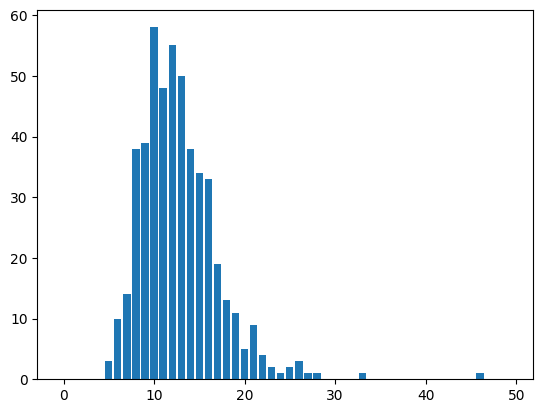

In [121]:
captions_lengths = [0] * 50
for yy in y:
    l = len(yy.split())
    if l < len(captions_lengths):
        captions_lengths[l] += 1
plt.bar(list(range(50)), captions_lengths)
plt.show()

In [122]:
max_len = 20

### Tokenize text: convert from text to numbers

In [123]:
#max_len = max([len(cpt.split()) for cpt in y])
num_words = len(frequent_vocabulary) + 1
tokenizer = keras.preprocessing.text.Tokenizer(num_words=num_words, oov_token='<UNK>', lower=False, filters='') # num_words=num_words, 
tokenizer.fit_on_texts(y)
tokenizer.word_index['<PAD>'] = 0
##### fix for keeping only most common `num_words`
tokenizer.word_index = {e:i for e,i in tokenizer.word_index.items() if i <= num_words} # <= because tokenizer is 1 indexed
#####
word2index = tokenizer.word_index
index2word = {v:k for k,v in word2index.items()}
#tokenize captions
y_tok = tokenizer.texts_to_sequences(y)

In [124]:
print(max_len)
print(len(frequent_vocabulary), len(word2index))

20
428 430


In [125]:
print('tokenized caption:', y_tok[1])
print('untokenized caption:', tokenizer.sequences_to_texts([y_tok[1]])[0])

tokenized caption: [2, 12, 7, 15, 6, 21, 1, 3]
untokenized caption: <START> هذه الصوره تحتوي علي المجهر <UNK> <END>


In [126]:
# split
test_size = 2*5
X_train = X[:-test_size]
y_train = y_tok[:-test_size]
X_test = X[-test_size:]
y_test = y_tok[-test_size:]

print(len(X_train), len(y_train))
print(len(X_test), len(y_test))

484 484
10 10


In [127]:
X_train

[array([[3.19678106e-09, 9.95446385e-07, 5.44686145e-07, 3.56380212e-07,
         6.03052604e-06, 5.03414910e-08, 1.13469625e-08, 6.97727387e-07,
         6.79096672e-08, 6.80903369e-08, 5.26404563e-07, 8.28780344e-07,
         2.71075692e-06, 1.18672358e-06, 7.78541471e-06, 5.13919247e-07,
         1.17313339e-05, 3.23196640e-04, 8.49804928e-06, 1.78796217e-05,
         1.56158052e-07, 1.59390481e-06, 2.56983874e-08, 2.07922923e-07,
         8.65350884e-08, 2.91949984e-08, 3.34702541e-08, 2.79617609e-08,
         4.64567016e-08, 2.41780924e-07, 1.43095605e-07, 1.33065396e-06,
         2.15490303e-07, 4.41142980e-08, 1.66631736e-07, 5.41669687e-09,
         4.90307514e-07, 2.13858904e-08, 1.21626229e-07, 2.12835721e-06,
         8.85323630e-07, 3.13711496e-07, 2.87950502e-06, 2.31577260e-07,
         1.16091869e-07, 3.27948442e-08, 4.40011081e-06, 3.67096959e-07,
         5.48295489e-08, 1.65571592e-08, 8.73352306e-08, 3.45457693e-07,
         2.80449910e-07, 1.81766552e-07, 6.39648647

In [128]:
import tensorflow.keras.preprocessing.sequence

%time

def prepare_data_for_model(images_features, cpts, max_len, vocab_size):
    input_image, input_text, output_text = [], [], []
    for img,cpt in zip(images_features,cpts):
        for i in range(1, len(cpt)): #for i in range(1, min(max_len,len(cpt))):
                # split into input and output pair
                in_text, out_text = cpt[:i], cpt[i]
                # pad input sequence
                in_text = tensorflow.keras.preprocessing.sequence.pad_sequences([in_text], maxlen=max_len, padding='post')[0]
                # encode output sequence
                out_text = keras.utils.to_categorical([out_text], num_classes=vocab_size)[0]
                # store
                input_image.append(img)
                input_text.append(in_text)
                output_text.append(out_text)
    return np.array(input_image, dtype=np.int16), np.array(input_text, dtype=np.int16), np.array(output_text, dtype=np.int16)

X_train_image, X_train_text, y_train_text = prepare_data_for_model(X_train, y_train, max_len, len(word2index))
X_train_image = np.squeeze(X_train_image)
print(X_train_image.shape, X_train_text.shape, y_train_text.shape)

X_test_image, X_test_text, y_test_text = prepare_data_for_model(X_test, y_test, max_len, len(word2index))
X_test_image = np.squeeze(X_test_image)
print(X_test_image.shape, X_test_text.shape, y_test_text.shape)

CPU times: total: 0 ns
Wall time: 0 ns
(5727, 1000) (5727, 20) (5727, 430)
(125, 1000) (125, 20) (125, 430)


### Building the model: seq2seq encoder-decoder (with GRU)

In [129]:
class My_Callback(keras.callbacks.Callback):
    
    def on_epoch_end(self, epoch, logs):
        logs['BLEU-train'] = self.calculate_bleu(X_train, y_train)
        logs['BLEU-test'] = self.calculate_bleu(X_test, y_test)
        print('BLEU-train:',logs['BLEU-train'],' BLEU-test:',logs['BLEU-test'])
        
    def chop_start_end(self, cpt):
        return cpt.split()[1:-1]
    
    def calculate_bleu(self, X, y):
        bt = []
        for xx,yy in zip(X,y):
            pred = predict_caption(self.model, xx, tokenizer, max_len)
            pred = self.chop_start_end(pred)
            actual = tokenizer.sequences_to_texts([yy])[0]
            actual = self.chop_start_end(actual)
            #print('actual >>',actual)
            #print('pred >>',pred)
            b = sentence_bleu([actual], pred, weights=(1, 0, 0, 0))
            bt.append(b)
        return np.mean(bt)

In [130]:
class Bleu_Callback(keras.callbacks.Callback):
    
    def on_epoch_end(self, epoch, logs):
        XX_test, yy_test = get_one_by_three(X_test, y_test)
        XX_test = np.squeeze(np.array(XX_test))
        yy_test_text = [tokenizer.sequences_to_texts(y_) for y_ in yy_test]
        generated_captions_test = generate_captions(self.model, XX_test)
        list_of_references = []
        for images_captions in yy_test_text:
            list_of_references.append([chop_start_end(cpt) for cpt in images_captions])
        hypotheses = [chop_start_end(cpt) for cpt in generated_captions_test]
        refs, hyps = {}, {}
        for i,(actual, pred) in enumerate(zip(list_of_references,hypotheses)):
            refs['id{}'.format(i)] = actual
            hyps['id{}'.format(i)] = [pred]
        b = Bleu(n=4)
        b1,b2,b3,b4 = b.compute_score(refs, hyps)[0]
        logs['b1'] = b1
        logs['b2'] = b2
        logs['b3'] = b3
        logs['b4'] = b4
        print('b1:',b1,'  b2',b2,'  b3',b3,'  b4',b4)
        
        # Sauvegarde du tokenizer
        with open('tokenizer.pkl', 'wb') as f:
            pickle.dump(tokenizer, f)

In [88]:
!pip install --upgrade tqdm keras keras_tqdm


In [131]:
import keras
import keras_tqdm

print("Version de Keras:", keras.__version__)




Version de Keras: 2.12.0


In [132]:
pip show keras-tqdm


Name: keras-tqdmNote: you may need to restart the kernel to use updated packages.

Version: 2.0.1
Summary: Keras models with TQDM progress bars in Jupyter notebooks
Home-page: https://github.com/bstriner/keras-tqdm
Author: Ben Striner
Author-email: bstriner@gmail.com
License: MIT
Location: C:\Users\pc\AIC\Lib\site-packages
Requires: Keras, tqdm
Required-by: 


In [133]:
import tensorflow as tf

embeddings_dim = 256
input_image_dim = X_train_image.shape[1]
max_len = X_train_text.shape[1]
vocab_size = len(word2index)

tf.keras.backend.clear_session()

# Image model
input_image = tf.keras.layers.Input(shape=(input_image_dim,), name='input_image')
image_embeddings = tf.keras.layers.Dense(embeddings_dim, activation='tanh', name='image_embeddings')(input_image)

# Text model
decoder_inputs = tf.keras.layers.Input(shape=(max_len,))
embeddings = tf.keras.layers.Embedding(vocab_size, embeddings_dim, mask_zero=True)(decoder_inputs)
gru = tf.keras.layers.GRU(embeddings_dim)(embeddings, initial_state=image_embeddings)
dense = tf.keras.layers.Dense(embeddings_dim, activation='relu')(gru)
decoder_outputs = tf.keras.layers.Dense(vocab_size, activation='softmax')(dense)

seq2seq = tf.keras.Model([input_image, decoder_inputs], decoder_outputs)
seq2seq.summary()

model_checkpoint_path = 'models/model.{epoch:02d}-{val_loss:.3f}.hdf5'
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(model_checkpoint_path, monitor='val_loss', verbose=1, save_best_only=False, save_weights_only=False, mode='auto')

seq2seq.compile(optimizer=tf.keras.optimizers.Adam(), loss='categorical_crossentropy')

seq2seq.fit([X_train_image, X_train_text], y_train_text,
            validation_data=([X_test_image, X_test_text], y_test_text),
            batch_size=20,
            epochs=10,
            verbose=1,
            callbacks=[checkpoint_callback])


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 20)]         0           []                               
                                                                                                  
 input_image (InputLayer)       [(None, 1000)]       0           []                               
                                                                                                  
 embedding (Embedding)          (None, 20, 256)      110080      ['input_1[0][0]']                
                                                                                                  
 image_embeddings (Dense)       (None, 256)          256256      ['input_image[0][0]']            
                                                                                              

In [134]:
print("Dimensions de X_train_image :", X_train_image.shape)
print("Dimensions de X_train_text :", X_train_text.shape)
print("Dimensions de y_train_text :", y_train_text.shape)
print("Dimensions de X_test_image :", X_test_image.shape)
print("Dimensions de X_test_text :", X_test_text.shape)
print("Dimensions de y_test_text :", y_test_text.shape)


Dimensions de X_train_image : (5727, 1000)
Dimensions de X_train_text : (5727, 20)
Dimensions de y_train_text : (5727, 430)
Dimensions de X_test_image : (125, 1000)
Dimensions de X_test_text : (125, 20)
Dimensions de y_test_text : (125, 430)


### save trained model

In [135]:
#from keras.models import load_model
seq2seq.save('models/seq2seq_no_dropout_3.h5')  # creates a HDF5 file 'my_model.h5'

In [136]:
seq2seq.save_weights('models/mine_model_weights.h5')

In [137]:
# import pickle

# # Chemin vers le fichier de votre modèle sauvegardé
# model_file_path = 'models/seq2seq_model.p'

# # Charger le modèle
# with open(model_file_path, 'rb') as file:
#     loaded_model = pickle.load(file)




In [138]:
# Utiliser le modèle chargé pour effectuer des prédictions
# predictions = loaded_model.predict([X_test_image, X_test_text])

### Predict & Evaluate

In [140]:
def predict_caption(model, images_features, tokenizer, maxlen):
    in_txt = '<START>'
    for word in range(max_len):
        seq = tokenizer.texts_to_sequences([in_txt])[0]
        seq = tf.keras.preprocessing.sequence.pad_sequences([seq], maxlen=maxlen)
        pred = model.predict([images_features, seq], verbose=0)
        pred = np.argmax(pred)
        new_word = index2word[pred]
        in_txt += ' ' + new_word
        if new_word == '<END>':
            #print('I saw END at index',word)
            break
    return in_txt

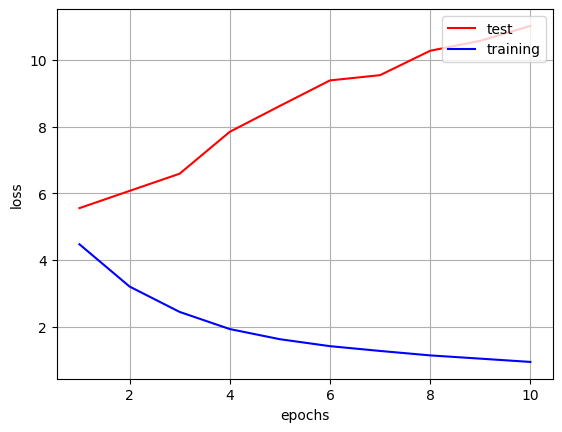

In [141]:
loss_train = seq2seq.history.history['loss']
loss_test = seq2seq.history.history['val_loss']
epochs = seq2seq.history.params['epochs']
epochs = range(1, epochs+1)

plt.plot(epochs, loss_test, 'r', label='test')
plt.plot(epochs, loss_train, 'b', label='training')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.legend(loc='upper right')
plt.grid(True)
plt.savefig("model_loss.png", dpi=200)
plt.show()

In [152]:
features

{'Image_1': array([[3.19678106e-09, 9.95446385e-07, 5.44686145e-07, 3.56380212e-07,
         6.03052604e-06, 5.03414910e-08, 1.13469625e-08, 6.97727387e-07,
         6.79096672e-08, 6.80903369e-08, 5.26404563e-07, 8.28780344e-07,
         2.71075692e-06, 1.18672358e-06, 7.78541471e-06, 5.13919247e-07,
         1.17313339e-05, 3.23196640e-04, 8.49804928e-06, 1.78796217e-05,
         1.56158052e-07, 1.59390481e-06, 2.56983874e-08, 2.07922923e-07,
         8.65350884e-08, 2.91949984e-08, 3.34702541e-08, 2.79617609e-08,
         4.64567016e-08, 2.41780924e-07, 1.43095605e-07, 1.33065396e-06,
         2.15490303e-07, 4.41142980e-08, 1.66631736e-07, 5.41669687e-09,
         4.90307514e-07, 2.13858904e-08, 1.21626229e-07, 2.12835721e-06,
         8.85323630e-07, 3.13711496e-07, 2.87950502e-06, 2.31577260e-07,
         1.16091869e-07, 3.27948442e-08, 4.40011081e-06, 3.67096959e-07,
         5.48295489e-08, 1.65571592e-08, 8.73352306e-08, 3.45457693e-07,
         2.80449910e-07, 1.81766552e-07,

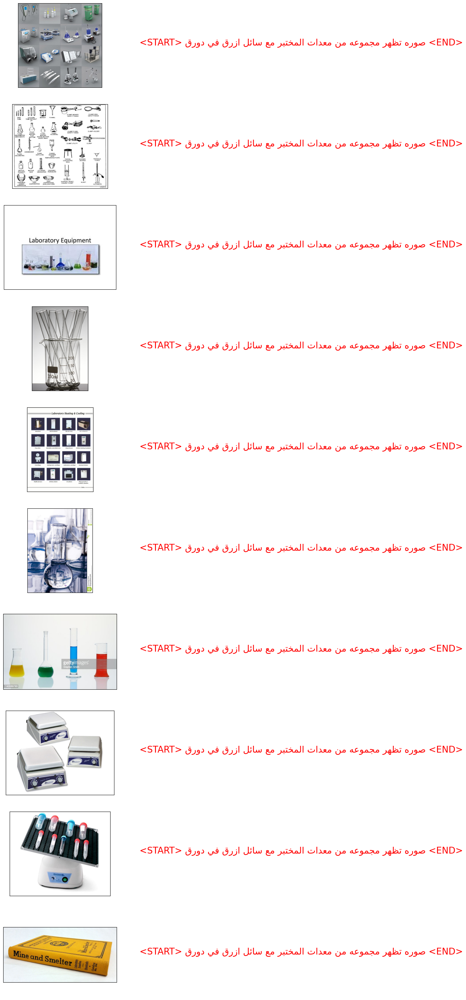

In [165]:
subset = {k:captions[k] for k in list(captions.keys())[-10:]}
pred = {}
for k,v in subset.items():
    cpt = predict_caption(seq2seq, features[k], tokenizer, max_len)
    pred[k] = [cpt]
visualize_images_with_captions(pred)

#good = [9, 10, 15, 18]
#bad = [21, 22, 29]

In [166]:
from tensorflow.keras.preprocessing.sequence import pad_sequences
def chop_start_end(cpt):
    if cpt.startswith('<START>') and cpt.endswith('<END>'):
        cpt = ' '.join(cpt.split()[1:-1])
    return cpt

def get_one_by_three(X,Y):
    XX,YY=[],[]
    for i,(x,y) in enumerate(zip(X,Y)):
        if i%3 == 0:
            XX.append(x)
            temp_y = [y]
        else:
            temp_y.append(y)
            if i%3 == 2:
                YY.append(temp_y)
    return XX,YY

"""
def generate_captions(model, X, y):
    references, hypothesis = [],[]
    d = []  # [{'actual_caption':list(str), 'predicted_captions':str}]
    XX,YY = get_one_by_three(X_train, y_train)
    for xx,yy in zip(XX,YY):
        ref = tokenizer.sequences_to_texts(yy)
        pred = predict_caption(model, xx, tokenizer, max_len)
        d.append({'actual_caption':ref, 'predicted_caption':pred})
    return d
"""

def generate_captions(model, image_features):
    n_images = image_features.shape[0]
    generated_captions = ['<START>'] * n_images
    for word in range(max_len):
        seq = tokenizer.texts_to_sequences(generated_captions)
        seq = pad_sequences(seq, maxlen=max_len)
        seq = np.squeeze(np.array(seq))
        predictions = model.predict([image_features, seq], verbose=0)
        predictions = np.argmax(predictions, axis=1)
        for i,pred in enumerate(predictions):
            if generated_captions[i].endswith('<END>'): continue
            new_word = index2word[pred]
            generated_captions[i] += ' ' + new_word
    return generated_captions

def BLEU_corpus(actual_captions, generated_captions):
    list_of_references = []
    for images_captions in actual_captions:
        list_of_references.append([chop_start_end(cpt).split() for cpt in images_captions])
    hypotheses = [chop_start_end(cpt).split() for cpt in generated_captions]
    b1 = corpus_bleu(list_of_references, hypotheses, weights=(1, 0, 0, 0))
    b2 = corpus_bleu(list_of_references, hypotheses, weights=(0.5, 0.5, 0, 0))
    b3 = corpus_bleu(list_of_references, hypotheses, weights=(0.333, 0.333, 0.333, 0))
    b4 = corpus_bleu(list_of_references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))
    return b1, b2, b3, b4

def BLEU_score(model, X, y):
    XX,YY = get_one_by_three(X_train, y_train)
    b1,b2,b3,b4 = [],[],[],[]
    for xx,yy in zip(XX,YY):
        ref = [tokenizer.sequences_to_texts([y_])[0] for y_ in yy]
        ref = [w for r in ref for w in chop_start_end(r).split()]
        ref = [list(set(ref))]
        pred = predict_caption(model, xx, tokenizer, max_len)
        pred = chop_start_end(pred).split()
        b1.append(sentence_bleu(ref, pred, weights=(1, 0, 0, 0)))
        b2.append(sentence_bleu(ref, pred, weights=(0.5, 0.5, 0, 0)))
        b3.append(sentence_bleu(ref, pred, weights=(1/3, 1/3, 1/3, 0)))
        b4.append(sentence_bleu(ref, pred, weights=(0.25, 0.25, 0.25, 0.25)))
    return np.mean(b1), np.mean(b2), np.mean(b3), np.mean(b4)

def plot_bleu_bar_graph(bleu_train, bleu_test):
    n_groups = 4
    #bleu_train = (b1_train,b2_train,b3_train,b4_train)
    #bleu_test = (b1_test,b2_test,b3_test,b4_test)
    # create plot
    fig, ax = plt.subplots()
    index = np.arange(n_groups)
    bar_width = 0.3
    opacity = 0.8

    rects1 = plt.bar(index, bleu_train, bar_width,
                     alpha=opacity,
                     color='b',
                     label='train',
                     zorder=3)

    rects2 = plt.bar(index + bar_width, bleu_test, bar_width,
                     alpha=opacity,
                     color='r',
                     label='test',
                     zorder=3)

    plt.xlabel('BLEU')
    plt.ylabel('score')
    #plt.title('Scores')
    plt.xticks(index + bar_width, ('1', '2', '3', '4'))
    plt.legend()
    plt.tight_layout()
    plt.grid(True, axis='y')
    plt.savefig("BLEU_bar.png", dpi=200)
    plt.show()

In [167]:
%%time
XX_train, yy_train = get_one_by_three(X_train, y_train)
XX_train = np.squeeze(np.array(XX_train))
yy_train_text = [tokenizer.sequences_to_texts(y_) for y_ in yy_train]

generated_captions_train = generate_captions(seq2seq, XX_train)

XX_test, yy_test = get_one_by_three(X_test, y_test)
XX_test = np.squeeze(np.array(XX_test))
yy_test_text = [tokenizer.sequences_to_texts(y_) for y_ in yy_test]

generated_captions_test = generate_captions(seq2seq, XX_test)

CPU times: total: 31.5 s
Wall time: 23.7 s


In [168]:
print(len(generated_captions_train))
print(len(yy_train_text))
print(len(generated_captions_test))
print(len(yy_test_text))


162
161
4
3


### Merge Model

In [169]:
# import tensorflow as tf

# embeddings_dim = 256
# input_image_dim = X_train_image.shape[1]
# max_len = X_train_text.shape[1]
# vocab_size = len(word2index)

# tf.keras.backend.clear_session()

# # Image model
# input_image = tf.keras.layers.Input(shape=(input_image_dim,), name='input_image')
# image_embeddings = tf.keras.layers.Dense(embeddings_dim, activation='tanh', name='image_embeddings')(input_image)

# # Text model
# decoder_inputs = tf.keras.layers.Input(shape=(max_len,))
# embeddings = tf.keras.layers.Embedding(vocab_size, embeddings_dim, mask_zero=True)(decoder_inputs)
# gru = tf.keras.layers.GRU(embeddings_dim)(embeddings, initial_state=image_embeddings)
# dense = tf.keras.layers.Dense(embeddings_dim, activation='relu')(gru)
# decoder_outputs = tf.keras.layers.Dense(vocab_size, activation='softmax')(dense)

# seq2seq = tf.keras.Model([input_image, decoder_inputs], decoder_outputs)
# seq2seq.summary()

# model_checkpoint_path = 'models/model.{epoch:02d}-{val_loss:.3f}.hdf5'
# checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(model_checkpoint_path, monitor='val_loss', verbose=1, save_best_only=False, save_weights_only=False, mode='auto')

# seq2seq.compile(optimizer=tf.keras.optimizers.Adam(), loss='categorical_crossentropy')

# seq2seq.fit([X_train_image, X_train_text], y_train_text,
#             validation_data=([X_test_image, X_test_text], y_test_text),
#             batch_size=20,
#             epochs=10,
#             verbose=1,
#             callbacks=[checkpoint_callback])


In [170]:
import tensorflow as tf
from keras_tqdm import TQDMNotebookCallback
from tensorflow.keras.callbacks import TensorBoard

embeddings_dim = 256
input_image_dim = X_train_image.shape[1]

# feature extractor model
inputs1 = tf.keras.layers.Input(shape=(input_image_dim,))
fe1 = tf.keras.layers.Dropout(0.3)(inputs1)
fe2 = tf.keras.layers.Dense(embeddings_dim, activation='relu')(fe1)
# sequence model
inputs2 = tf.keras.layers.Input(shape=(max_len,))
se1 = tf.keras.layers.Embedding(len(word2index), embeddings_dim, mask_zero=True)(inputs2)
se2 = tf.keras.layers.Dropout(0.3)(se1)
se3 = tf.keras.layers.LSTM(embeddings_dim)(se2)
# decoder model
decoder1 = tf.keras.layers.concatenate([fe2, se3])
decoder2 = tf.keras.layers.Dense(embeddings_dim, activation='relu')(decoder1)
outputs = tf.keras.layers.Dense(len(word2index), activation='softmax')(decoder2)
# tie it together [image, seq] [word]
merge_model = tf.keras.Model(inputs=[inputs1, inputs2], outputs=outputs)
# compile model
merge_model.compile(loss='categorical_crossentropy', optimizer='adam')
# summarize model
merge_model.summary()
#plot_model(model, to_file='others/merge_model.png', show_shapes=True)

merge_model.fit([X_train_image, X_train_text], y_train_text,
          validation_data=([X_test_image, X_test_text], y_test_text),
          batch_size=1024,
          epochs=10,
          verbose=2,
          callbacks=[TensorBoard(log_dir='./logs')])



Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 20)]         0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, 1000)]       0           []                               
                                                                                                  
 embedding_2 (Embedding)        (None, 20, 256)      110080      ['input_5[0][0]']                
                                                                                                  
 dropout_2 (Dropout)            (None, 1000)         0           ['input_4[0][0]']                
                                                                                            

In [171]:
b1_train,b2_train,b3_train,b4_train = BLEU_score(merge_model, X_train, y_train)
b1_test,b2_test,b3_test,b4_test = BLEU_score(merge_model, X_test, y_test)

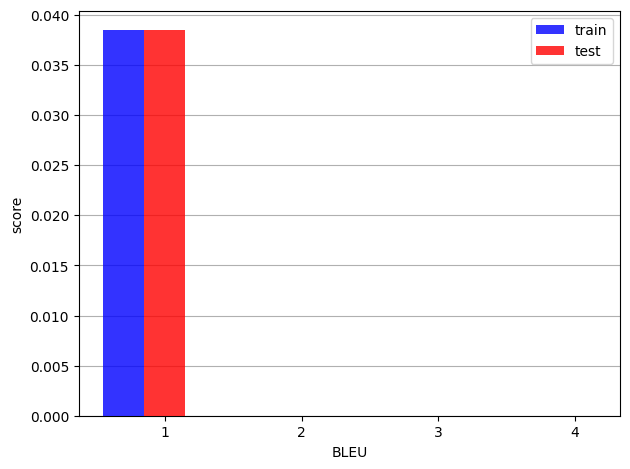

In [172]:
plot_bleu_bar_graph((b1_train,b2_train,b3_train,b4_train), (b1_test,b2_test,b3_test,b4_test))

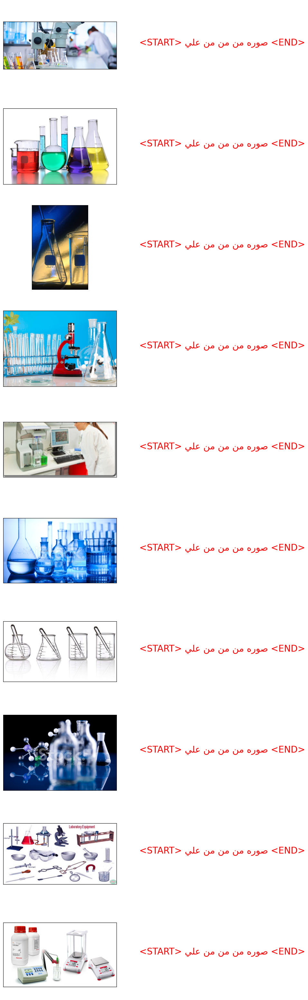

In [177]:
subset = {k:captions[k] for k in list(captions.keys())[20:30]}
pred = {}
for k,v in subset.items():
    cpt = predict_caption(merge_model, features[k], tokenizer, max_len)
    pred[k] = [cpt]
visualize_images_with_captions(pred)

#good = [9, 10, 15, 18]
#bad = [21, 22, 29]

In [79]:
!pip install streamlit

!pip install pyngrok
from  pyngrok import ngrok